# Fit for 1 PN Data

## Import libraries and define constants

In [1]:
import numpy as np
from scipy.integrate import solve_ivp
from lmfit import Model, Parameters
import matplotlib.pyplot as plt

#Have nice axes with LaTeX
plt.rcParams["text.usetex"] = True

# Define constants
G = 6.67e-11
m1, m2 = 10 * 1.9e30, 10 * 1.9e30
m = m1 + m2
qstan = m2/m1
c = 299792458

## Numerical integration of 1PN Differential equations

In [2]:
# Function for the differential equation
def dydt(F: list[float], e: list[float], m1: float, m2: float) -> list[float]:
    eta = m1*m2 / (m1+m2)**2
    m = m1+m2
    x = ((G*m*F)/c**3) ** (2/3)
    x1PN = (-11888 - 14784*eta + e**2 * (87720 - 159600*eta) + e**4 * (171038 - 141708*eta) + e**6 * (11717 - 8288*eta))/(420*(1-e**2)**(9/2))
    e1PN = -(67608 + 228704 * eta + e**2 * (-718008 + 651252*eta) + e**4 * (-125361 + 93184 * eta))/(2520*(1-e**2)**(7/2))
    return -2*e* (G*m/c**3)**(2/3)/(3*x*F**(1/3)) * ((304 + 121*e**2)/(15*(1-e**2)**(5/2)) + e1PN * x) / ((192 + 584 * e**2 + 74 * e**4)/(15*(1-e**2)**(7/2)) + x1PN * x)

In [26]:
N = 10000 

# Define initial conditions and other variables
initialEccentricities = np.linspace(0, 1, N)

# Solve ewuations numerically
solutions = []
for e0 in initialEccentricities:
    sol = solve_ivp(
        dydt,
        [20, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
        [e0],
        t_eval=np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), N),
    )
    solutions.append(sol)

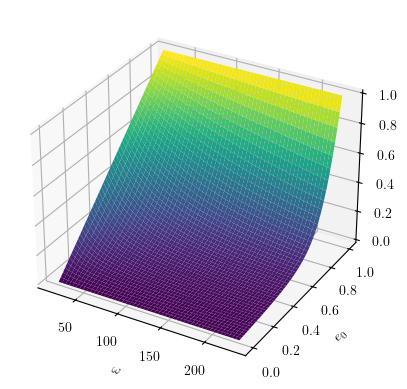

In [27]:
# Create mesh grids for F and e_0
F, e0 = np.meshgrid(
    np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), N), initialEccentricities
)
e = np.array([sol.y[0] for sol in solutions])

# Plot the 3D grid
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

ax.plot_surface(F, e0, e, cmap="viridis")

ax.set_xlabel(r"$\omega$")
ax.set_ylabel(r"$e_0$")
ax.set_zlabel(r"$e$")
plt.show()

## Fitting of numerical integration 

In [28]:
#Define fitmodel
def model(e0, F, a, b, c, d, f, g):
    e0[e0 < 1e-15] = 1e-15
    beta = (
        np.power(F / 20, 2 / 3)
        * np.power(e0, (-12 / 19))
        * (1 - np.power(e0, 2))
        * np.power(1 + 121 / 304 * np.power(e0, 2), (-870 / 2299))
    )

    beta[beta < 1e-15] = 1e-15

    e = (a + b * np.power(beta, c)) / (d + f * np.power(beta, g))
    return e

In [29]:
# Set initial parameters for the fit
params = Parameters()
params.add("a", value=17)
params.add("b", value=4)
params.add("c", value=0.4)
params.add("d", value=16)
params.add("f", value=8)
params.add("g", value=1.5)

# Create a Model object
fitmodel = Model(model, independent_vars=["F", "e0"])

# Perform fitting
fit = fitmodel.fit(
    e,
    F=F,
    e0=e0,
    method="leastsq",
    params=params,
)

# Print fitting report
print(fit.fit_report())

[[Model]]
    Model(model)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 185
    # data points      = 100000000
    # variables        = 6
    chi-square         = 901.150865
    reduced chi-square = 9.0115e-06
    Akaike info crit   = -1.1617e+09
    Bayesian info crit = -1.1617e+09
    R-squared          = 0.99988383
[[Variables]]
    a:  5.94995740 +/- 48.3941944 (813.35%) (init = 17)
    b: -1.27646593 +/- 10.3822635 (813.36%) (init = 4)
    c:  0.33136108 +/- 4.6766e-05 (0.01%) (init = 0.4)
    d:  5.64918510 +/- 45.9481571 (813.36%) (init = 16)
    f:  2.97775601 +/- 24.2196156 (813.35%) (init = 8)
    g:  1.67220515 +/- 7.0700e-05 (0.00%) (init = 1.5)
[[Correlations]] (unreported correlations are < 0.100)
    C(a, d) = +1.0000
    C(d, f) = +1.0000
    C(a, f) = +1.0000
    C(a, b) = -1.0000
    C(b, d) = -1.0000
    C(b, f) = -1.0000
    C(b, g) = -0.9864
    C(a, g) = +0.9864
    C(f, g) = +0.9864
    C(d, g) = +0.9864
    C(c, g) = -0.8673
    C

In [30]:
# Save F, e, e0 as plain text files
np.savetxt("F1PN.txt", F)
np.savetxt("e1PN.txt", e)
np.savetxt("e01PN.txt", e0)

# Save fit.best_result as a plain text file
np.savetxt("best_fit1PN.txt", fit.best_fit)

## Visualizing results

In [3]:
# Load e, F, e0
e = np.loadtxt("e1PN.txt")
F = np.loadtxt("F1PN.txt")
e0 = np.loadtxt("e01PN.txt")

# Load fit.best_result
best_fit = np.loadtxt("best_fit1PN.txt")

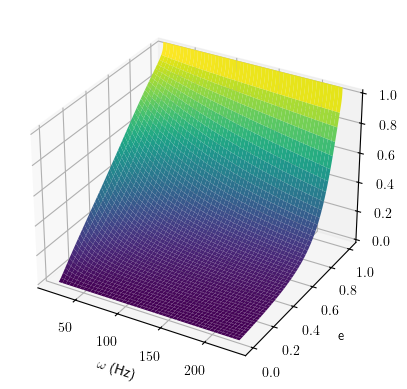

In [4]:
efit = np.reshape(best_fit, F.shape)

# Plot the 3D figure of the fitted function
fig = plt.figure()
ax = fig.add_subplot(projection="3d")
ax.plot_surface(F, e0, efit, cmap="viridis")
ax.set_xlabel(r"$\omega$ (Hz)")
ax.set_ylabel(r"e")
ax.set_zlabel(r"$e_0$")
ax.set_zlim(0, 1)
plt.show()

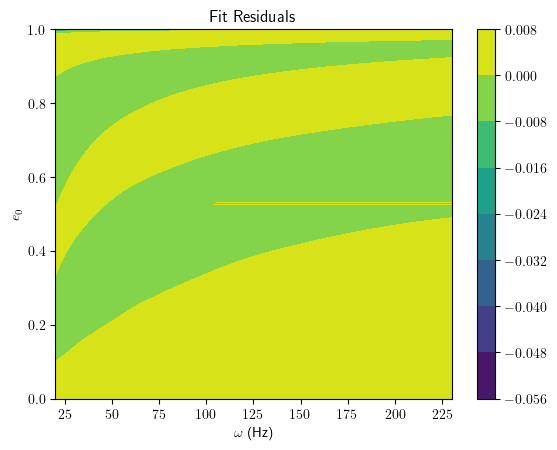

In [5]:
plt.contourf(F, e0, e - efit, cmap="viridis")
plt.ylabel(r"$e_0$")
plt.xlabel(r"$\omega$ (Hz)")
plt.title("Fit Residuals")
plt.colorbar()
plt.show()

In [6]:
levels = [0.1, 0.25, 0.4, 0.65, 0.8, 0.95]
labels = [rf"$e_0$ = {level}" for level in levels]

colours = ["orange", "green", "red", "blue", "yellow", "black"]
handles = [plt.Line2D([], [], color=color) for color in colours]

C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\1829741706.py:5: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  mesh1 = ax1.pcolormesh(F, e, e0, cmap="RdPu")
C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\1829741706.py:16: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  mesh2 = ax2.pcolormesh(F, efit, e0, cmap="RdPu")


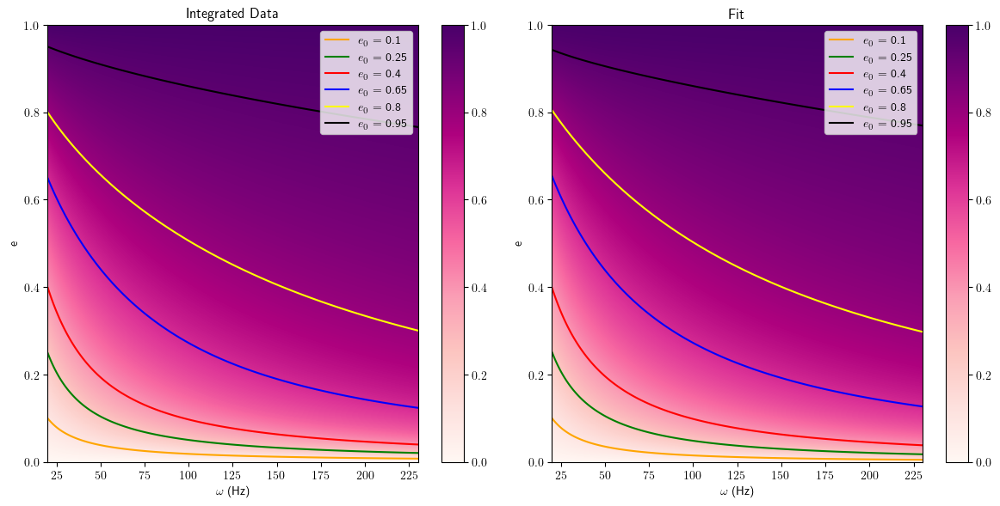

In [7]:

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Plot the interpolated data in ax1
mesh1 = ax1.pcolormesh(F, e, e0, cmap="RdPu")
contour1 = ax1.contour(F, e, e0, levels, colors=colours)

ax1.set_xlabel(r"$\omega$ (Hz)")
ax1.set_ylabel(r"e")
ax1.set_ylim(0, 1)
ax1.set_title("Integrated Data")
plt.colorbar(mesh1, ax=ax1)
legend = ax1.legend(handles, labels, loc="upper right")

# Plot the fitted version in ax2
mesh2 = ax2.pcolormesh(F, efit, e0, cmap="RdPu")
contour2 = ax2.contour(F, efit, e0, levels, colors=colours)

ax2.set_xlabel(r"$\omega$ (Hz)")
ax2.set_ylabel(r"e")
ax2.set_ylim(0, 1)
ax2.set_title("Fit")
plt.colorbar(mesh2, ax=ax2)
legend = ax2.legend(handles, labels, loc="upper right")

plt.tight_layout()
plt.show()

C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\2128587808.py:19: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for i, colour, level in zip(range(len(contour1.collections)), colours, levels):


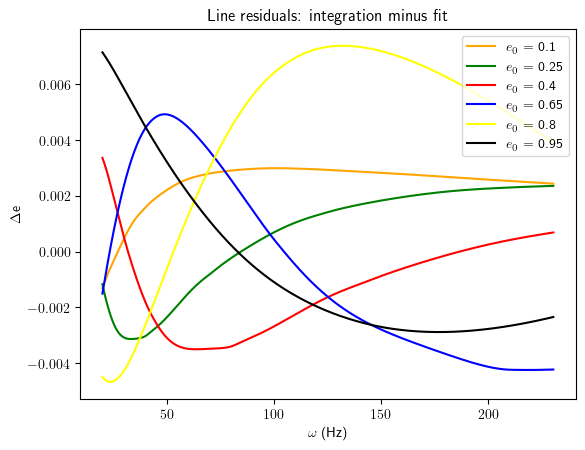

C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\2128587808.py:40: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for i, colour, level in zip(range(len(contour1.collections)), colours, levels):


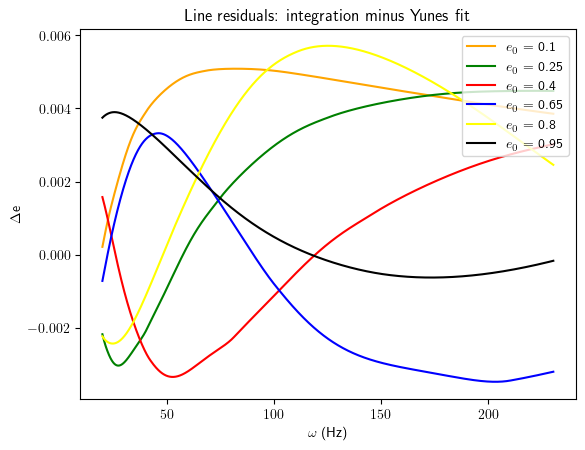

C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\2128587808.py:61: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for i, colour, level in zip(range(len(contour2.collections)), colours, levels):


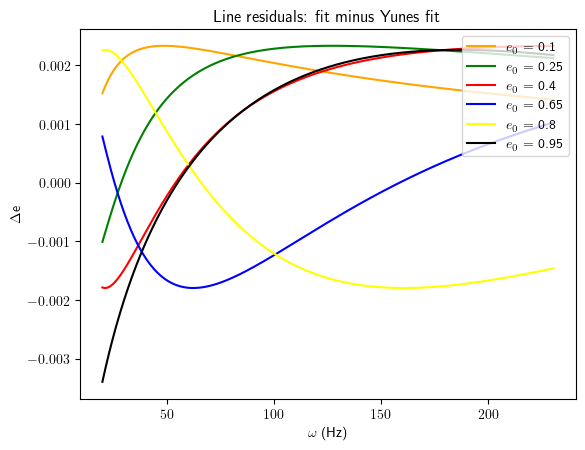

In [27]:
def yunes(e0, F):
    beta = (
        np.power(F / 20, 2 / 3)
        * np.power(e0, (-12 / 19))
        * (1 - np.power(e0, 2))
        * np.power(1 + 121 / 304 * np.power(e0, 2), (-870 / 2299))
    )
    return (16.83 - 3.814*beta**0.3858)/(16.04 + 8.1*beta**1.637)

def fitted(e0, F):
    beta = (
        np.power(F / 20, 2 / 3)
        * np.power(e0, (-12 / 19))
        * (1 - np.power(e0, 2))
        * np.power(1 + 121 / 304 * np.power(e0, 2), (-870 / 2299))
    )
    return (0.35958580 - 0.06820075*beta**0.37100404)/(0.34809688 + 0.19311034*beta**1.63793912)

for i, colour, level in zip(range(len(contour1.collections)), colours, levels):

    e_contour1 = solve_ivp(
        lambda F, y: dydt(F, y, m=m),
        [20, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
        [level],
        t_eval=np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000),
    )

    e_contour2 = fitted(level, np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000))

    # Subtract y-values of corresponding points along contour lines
    delta_e = e_contour1.y[0] - e_contour2
    plt.plot(F_contour, delta_e, color=colour, label=fr"$e_0$ = {level}")

plt.legend(loc="upper right")
plt.xlabel(r"$\omega$ (Hz)")
plt.ylabel(r"$\Delta$e")
plt.title("Line residuals: integration minus fit")
plt.show()

for i, colour, level in zip(range(len(contour1.collections)), colours, levels):
    # Extract contour line coordinates for dataset 1
    e_contour1 = solve_ivp(
        lambda F, y: dydt(F, y, m=m),
        [20, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
        [level],
        t_eval=np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000),
    )

    e_contour2 = yunes(level, np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000))

    # Subtract y-values of corresponding points along contour lines
    delta_e = e_contour1.y[0] - e_contour2
    plt.plot(F_contour, delta_e, color=colour, label=fr"$e_0$ = {level}")

plt.legend(loc="upper right")
plt.xlabel(r"$\omega$ (Hz)")
plt.ylabel(r"$\Delta$e")
plt.title("Line residuals: integration minus Yunes fit")
plt.show()

for i, colour, level in zip(range(len(contour2.collections)), colours, levels):
    # Extract contour line coordinates for dataset 1

    e_contour1 = fitted(level, np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000))

    e_contour2 = yunes(level, np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 10000))

    # Subtract y-values of corresponding points along contour lines
    delta_e = e_contour1 - e_contour2
    plt.plot(F_contour, delta_e, color=colour, label=fr"$e_0$ = {level}")

plt.legend(loc="upper right")
plt.xlabel(r"$\omega$ (Hz)")
plt.ylabel(r"$\Delta$e")
plt.title("Line residuals: fit minus Yunes fit")
plt.show()

C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\1864848198.py:1: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for i, colour, level in zip(range(len(contour1.collections)), colours, levels):
C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\1864848198.py:3: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  contour1_paths = contour1.collections[i].get_paths()
C:\Users\aminr\AppData\Local\Temp\ipykernel_6960\1864848198.py:9: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  contour2_paths = contour2.collections[i].get_paths()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


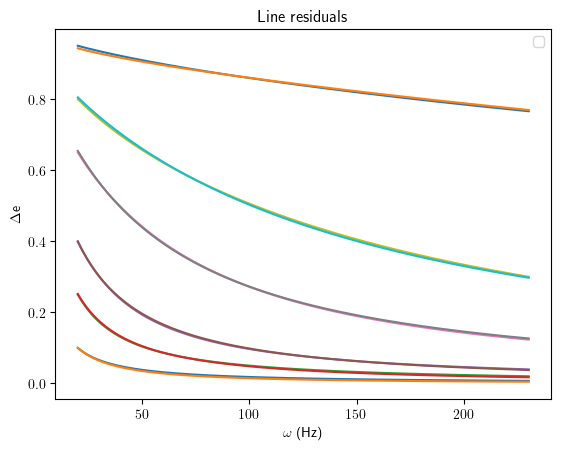

In [9]:
for i, colour, level in zip(range(len(contour1.collections)), colours, levels):
    # Extract contour line coordinates for dataset 1
    contour1_paths = contour1.collections[i].get_paths()
    contour1_coords = [path.vertices for path in contour1_paths]
    F_contour = contour1_coords[0][:, 0]
    e_contour1 = contour1_coords[0][:, 1]

    # Extract contour line coordinates for dataset 2
    contour2_paths = contour2.collections[i].get_paths()
    contour2_coords = [path.vertices for path in contour2_paths]
    e_contour2 = contour2_coords[0][:, 1]

    # Subtract y-values of corresponding points along contour lines
    delta_e = e_contour1 - e_contour2
    plt.plot(F_contour, e_contour1)
    plt.plot(F_contour, e_contour2)

plt.legend(loc="upper right")
plt.xlabel(r"$\omega$ (Hz)")
plt.ylabel(r"$\Delta$e")
plt.title("Fit and Integration contours")
plt.show()

In [37]:
initialEccentricities = [0.001, 0.01, 0.2, 0.3, 0.4, 0.5, 0.6, 0.9]
qlist = [0.25, 0.5, 0.75, 1]
qsoldict = {}
for q in qlist:
    qsoldict[q] = []
    for e0 in initialEccentricities:
        sol = solve_ivp(
            lambda F, y: dydt(F, y, q=q),
            [10, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
            [e0],
            t_eval=np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * m), 1000),
        )
        qsoldict[q].append(sol)

mlist = [5 * 1.99 * 10**30, 10 * 1.99 * 10**30, 20 * 1.99 * 10**30, 50 * 1.99 * 10**30]
F_values = [c**3 / (6 ** (3 / 2) * np.pi * G * m) for m in mlist]
t_eval_common = np.linspace(10, min(F_values), 1000)

msoldict = {}
for m in mlist:
    msoldict[m] = []
    for e0 in initialEccentricities:
        sol = solve_ivp(
            lambda F, y: dydt(F, y, m=m),
            [10, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
            [e0],
            t_eval=t_eval_common,
        )
        msoldict[m].append(sol)

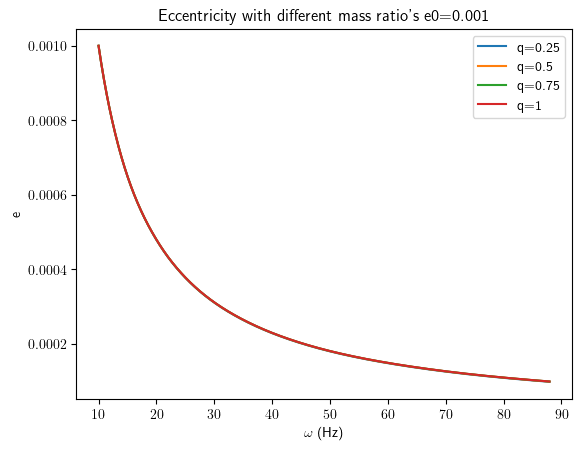

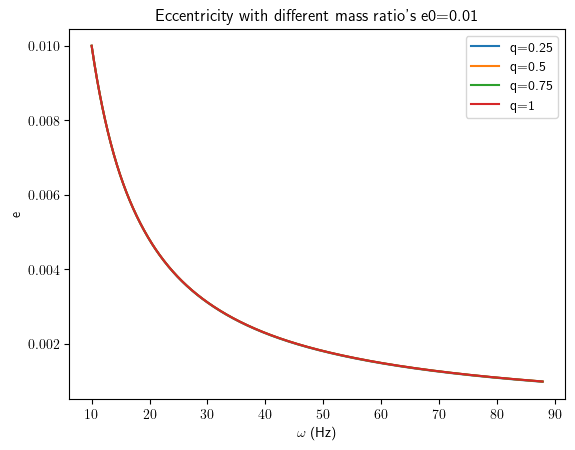

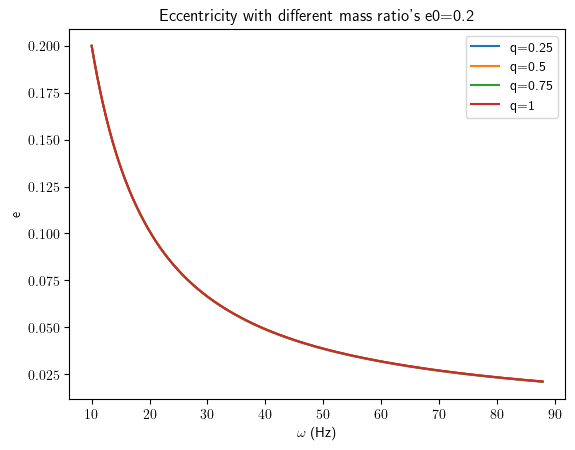

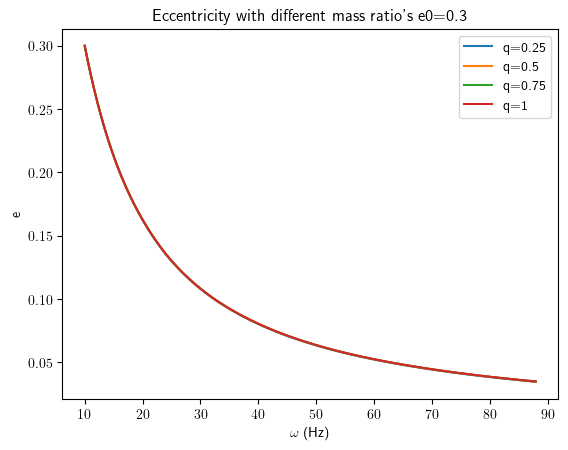

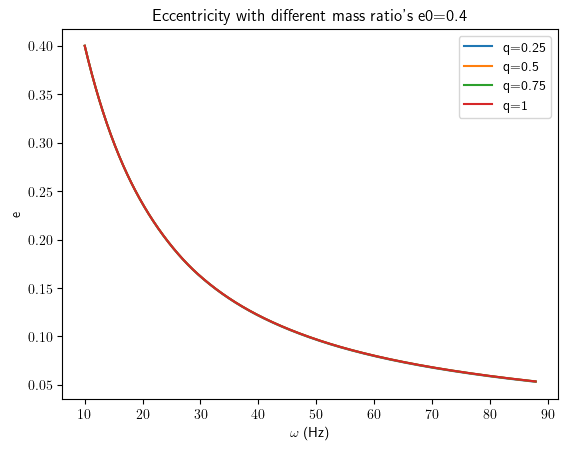

...

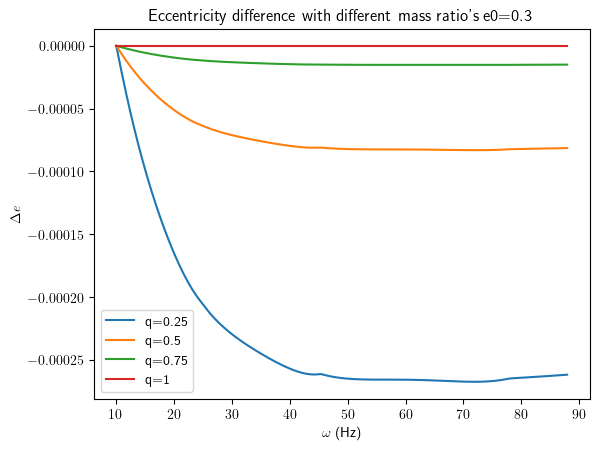

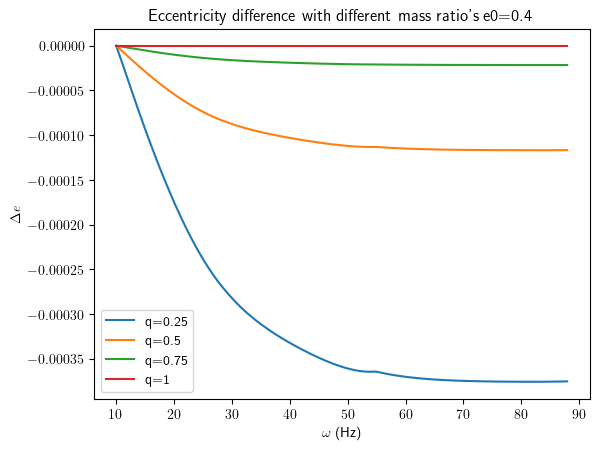

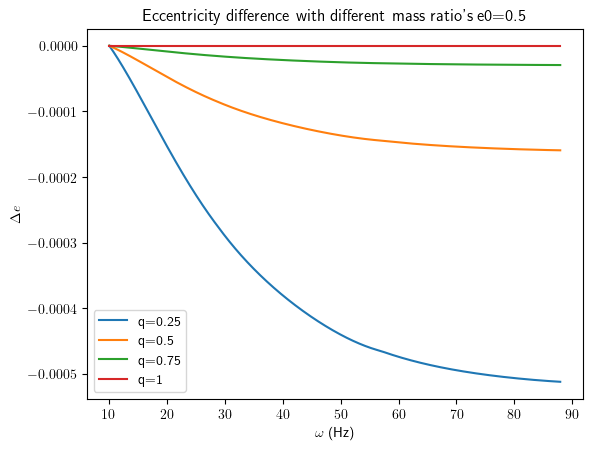

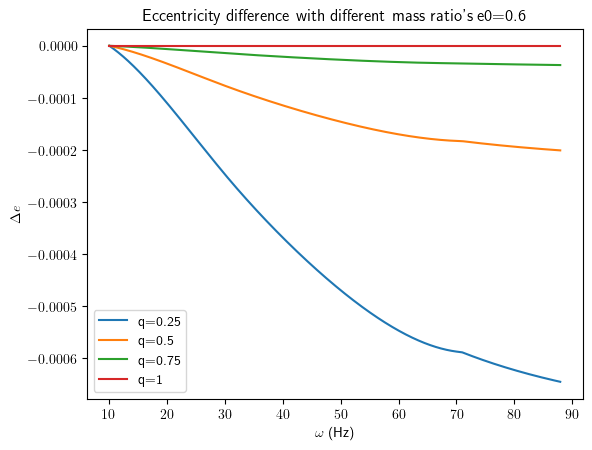

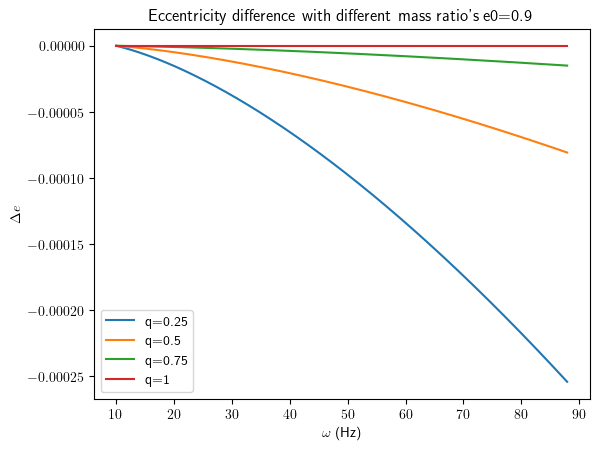

In [38]:
for i, e0 in enumerate(initialEccentricities):
    # Plot the results for the current q
    plt.figure()
    for q in qlist: #sol in solutions
        plt.plot(qsoldict[q][i].t, qsoldict[q][i].y[0], label=f"q={q}")

    plt.xlabel(r'$\omega$ (Hz)')
    plt.ylabel(r'e')
    plt.title(f'Eccentricity with different mass ratio\'s e0={e0}')
    plt.legend()
    plt.show()

for i, e0 in enumerate(initialEccentricities):
    # Plot the results for the current q
    plt.figure()
    for q in qlist: #sol in solutions
        plt.plot(qsoldict[q][i].t, qsoldict[q][i].y[0] - qsoldict[1][i].y[0], label=f"q={q}")

    plt.xlabel(r'$\omega$ (Hz)')
    plt.ylabel(r'$\Delta e$')
    plt.title(f'Eccentricity difference with different mass ratio\'s e0={e0}')
    plt.legend()
    plt.show()

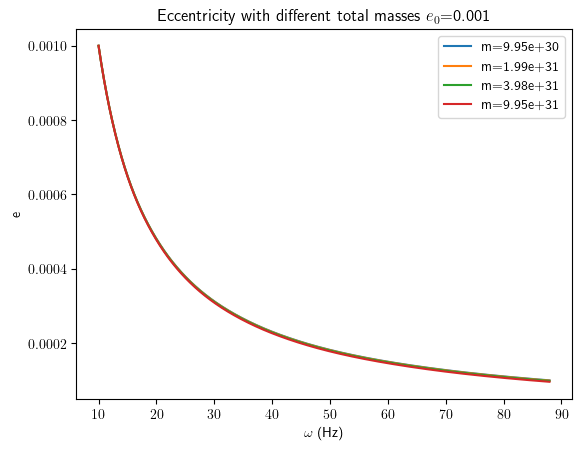

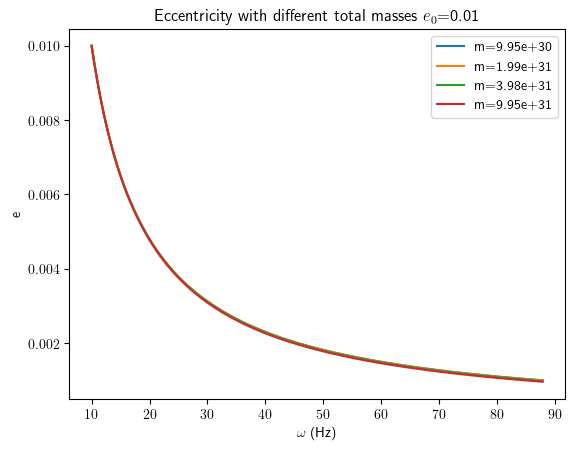

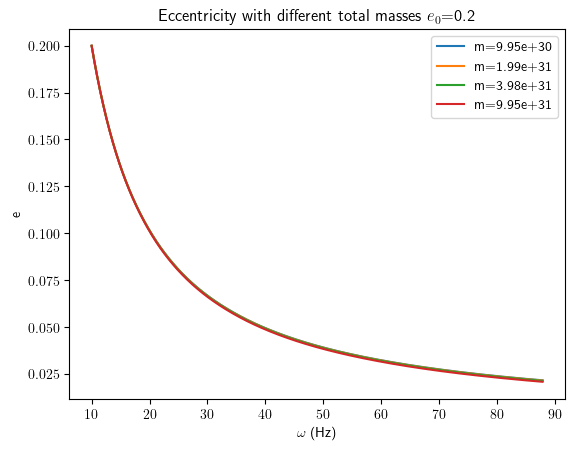

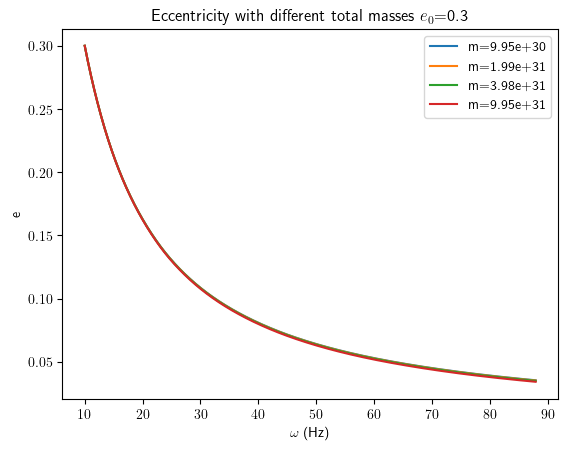

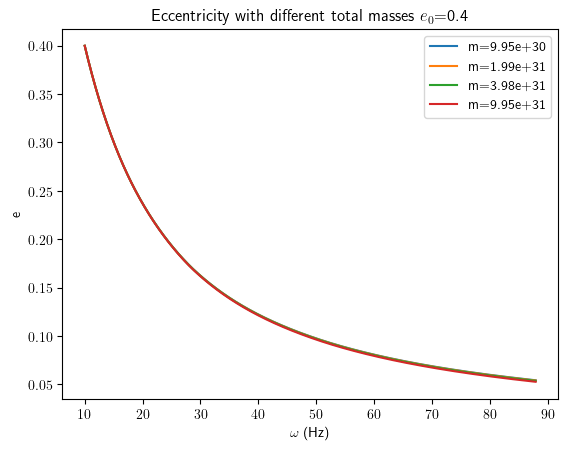

...

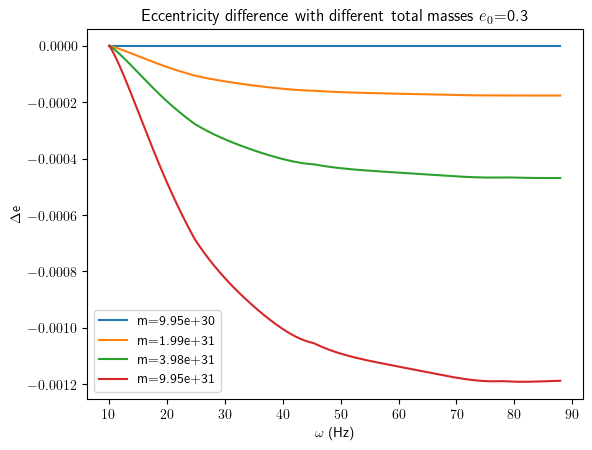

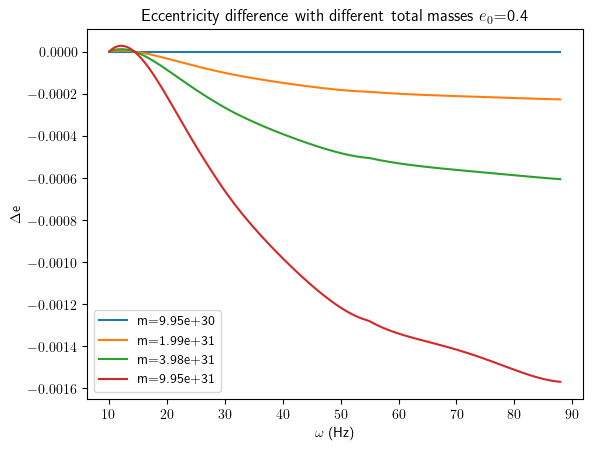

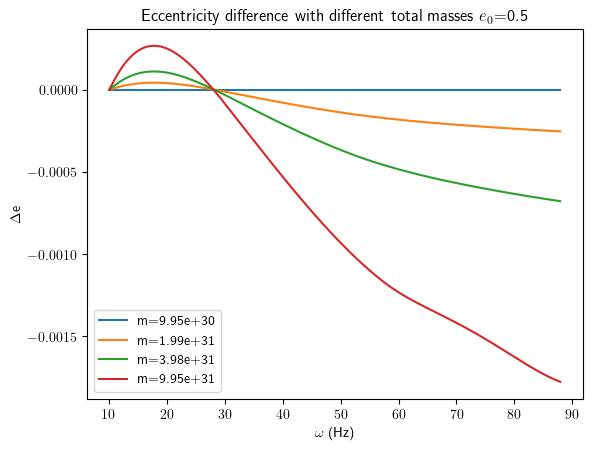

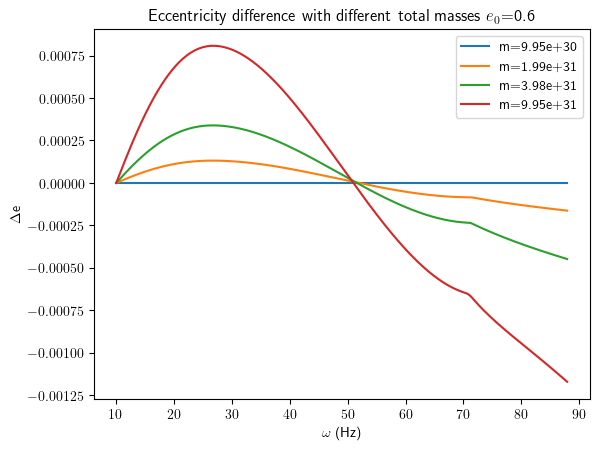

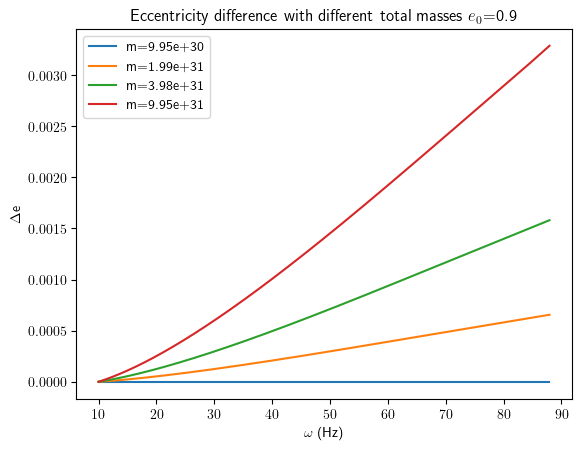

In [39]:
for i, e0 in enumerate(initialEccentricities):    
    # Plot the results for the current q
    plt.figure()
    for m in mlist: #sol in solutions
        plt.plot(msoldict[m][i].t, msoldict[m][i].y[0], label=f"m={m}")

    plt.xlabel(r'$\omega$ (Hz)')
    plt.ylabel(r'e')
    plt.title(fr'Eccentricity with different total masses $e_0$={e0}')
    plt.legend()
    plt.show()

for i, e0 in enumerate(initialEccentricities):
    # Plot the results for the current q
    plt.figure()
    for m in mlist:
        plt.plot(msoldict[m][i].t, msoldict[m][i].y[0] - msoldict[9.95e+30][i].y[0], label=f"m={m}")

    plt.xlabel(r'$\omega$ (Hz)')
    plt.ylabel(r'$\Delta$e')
    plt.title(fr'Eccentricity difference with different total masses $e_0$={e0}')
    plt.legend()
    plt.show()

In [13]:
mlist = [5*1.99*10**30, 50*1.99*10**30]
qlist = [0.2, 1]
solarray = [[], []], [[], []]
for i, q in enumerate(qlist):
    for j, m in enumerate(mlist):
        for e0 in initialEccentricities:
            sol = solve_ivp(
                lambda F, y: dydt(F, y, q = q, m=m),
                [20, c**3 / (6 ** (3 / 2) * np.pi * G * m)],
                [e0],
                t_eval=np.linspace(20, c**3 / (6 ** (3 / 2) * np.pi * G * m), 1000),
            )
            solarray[i][j].append(sol)

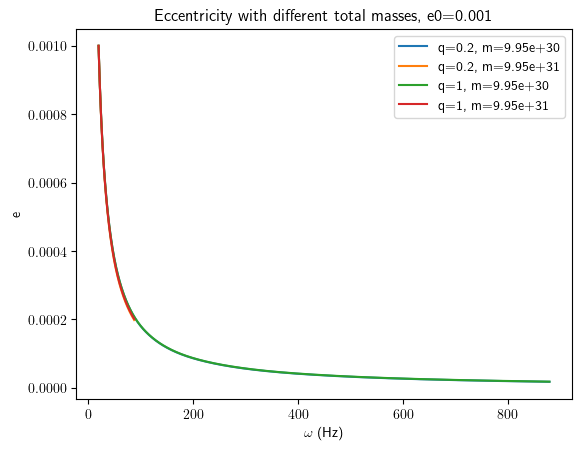

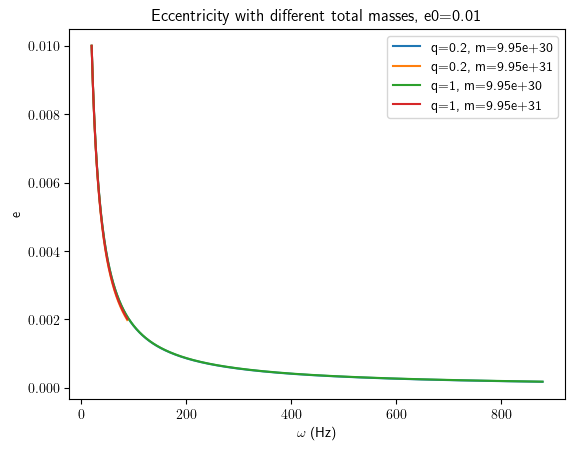

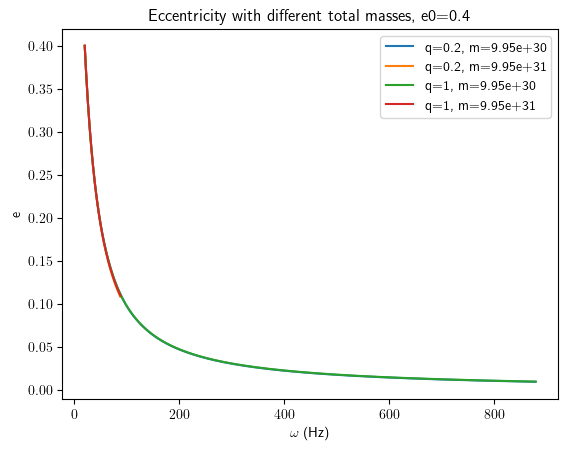

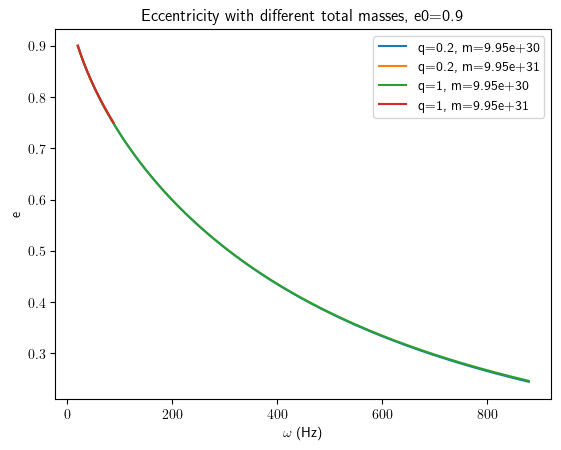

In [14]:
for i, e0 in enumerate(initialEccentricities):    
    # Plot the results for the current e0
    plt.figure()
    for j, q in enumerate(qlist):
        for k, m in enumerate(mlist):
            plt.plot(solarray[j][k][i].t, solarray[j][k][i].y[0], label=f"q={q}, m={m}")

    plt.xlabel(r'$\omega$ (Hz)')
    plt.ylabel(r'e')
    plt.title(f'Eccentricity with different total masses, e0={e0}')
    plt.legend()
    plt.show()

# Now ML

In [3]:
from pysr import PySRRegressor
import pandas as pd

Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


In [4]:
N = 10

e0s = np.linspace(1e-15, 0.3, N)
m1s = np.linspace(5*2*10**30, 20*2*10**30, N)
m2s = np.linspace(5*2*10**30, 20*2*10**30, N)

es = []
Fs = []
etas = []
ms = []
for m1 in m1s:
    for m2 in m2s:
        for e0 in e0s:
            sol = solve_ivp(
                lambda F, y: dydt(F, y, m1=m1, m2=m2),
                [10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2))],
                [e0],
                t_eval=np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N),
            )
            etas.extend(np.repeat(m1*m2/(m1+m2)**2, N))
            ms.extend(np.repeat(m1+m2, N))
            Fs.extend(sol.t)
            es.extend(sol.y[0])

In [5]:
e0_data = np.repeat(np.tile(e0s, N**2), N)

data = pd.DataFrame({'chi': np.asarray(Fs)/10, 'e0': e0_data, "eta": np.asarray(etas), "m": np.asarray(ms)})

In [6]:
model = PySRRegressor(
    model_selection="accuracy",
    binary_operators=["+", "-", "*", "/", "^"], 
    unary_operators=["log", "exp"], 
    nested_constraints = {"log": {"exp": 0}, "exp": {"log": 0}},
    constraints = {"^": (-1,1)},
    maxsize = 50,
    populations = 50,
    population_size = 50,
    niterations=1000,
    precision=64,
)

In [7]:
model.fit(data, es)

c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\pysr\sr.py:1236: UserWarning: Note: Using a large maxsize for the equation search will be exponentially slower and use significant memory.
  warnings.warn(
c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\pysr\sr.py:1307: UserWarning: Note: it looks like you are running in Jupyter. The progress bar will be turned off.
  warnings.warn(


Compiling Julia backend...


[ Info: Started!



Expressions evaluated per second: 0.000e+00
Head worker occupation: 0.0%
Progress: 0 / 50000 total iterations (0.000%)
Hall of Fame:
---------------------------------------------------------------------------------------------------
Complexity  Loss       Score     Equation
---------------------------------------------------------------------------------------------------
Press 'q' and then <enter> to stop execution early.

Expressions evaluated per second: 2.020e+02
Head worker occupation: 0.0%
Progress: 1 / 50000 total iterations (0.002%)
Hall of Fame:
---------------------------------------------------------------------------------------------------
Complexity  Loss       Score     Equation
3           2.468e-06  1.201e+01  y = e0 / chi
---------------------------------------------------------------------------------------------------
Press 'q' and then <enter> to stop execution early.

Expressions evaluated per second: 3.410e+03
Head worker occupation: 0.7%
Progress: 16 / 50000 to

PySRRegressor.equations_ = [
	    pick     score                                           equation  \
	0         0.000000                                0.03247424693139087   
	1         3.533797                                           e0 / chi   
	2         0.083867                -0.0006173644531739583 + (e0 / chi)   
	3         0.073690  ((e0 / chi) ^ 0.9934755794052199) - 0.00119012...   
	4         0.085066  1.051471961135586 * ((e0 / (chi - -0.039582385...   
	5         0.083137  (e0 / (chi + (-0.09343575690841076 * log(chi))...   
	6         0.434144  (e0 / (((e0 / chi) + chi) - e0)) - 0.001172870...   
	7         0.334112  (e0 / (chi - ((e0 + -0.14485588261006624) * lo...   
	8         1.629451  6.600749284202429e-5 + ((e0 / (chi + e0)) * ((...   
	9         0.071353  ((e0 + exp(-1.152142632083613e-5)) * (e0 / ((c...   
	10        0.096705  ((e0 + (chi ^ -0.057291842690226684)) * (e0 / ...   
	11        0.037797  ((e0 / (((chi ^ 1.1128507119993423) * 0.922935...   
	12        0.073570  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * (e...   
	13        0.316698  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * (e...   
	14        0.006864  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * (e...   
	15        0.001611  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * (e...   
	16        0.001385  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * (e...   
	17        0.037816  ((e0 / (e0 + (chi ^ 1.1219627016425717))) * ((...   
	18        0.022087  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	19        0.025453  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	20        0.014183  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	21        0.006232  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	22        0.010619  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	23        0.001700  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	24        0.005691  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	25        0.000555  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	26  >>>>  0.001788  ((e0 / ((chi ^ 1.1219627016425717) + e0)) * ((...   
	
	            loss  complexity  
	0   2.895964e-03           1  
	1   2.468177e-06           3  
	2   2.087038e-06           5  
	3   1.801042e-06           7  
	4   1.519274e-06           9  
	5   1.398074e-06          10  
	6   9.056991e-07          11  
	7   6.484564e-07          12  
	8   1.271216e-07          13  
	9   1.183671e-07          14  
	10  1.074565e-07          15  
	11  9.963279e-08          17  
	12  7.423321e-08          21  
	13  5.408264e-08          22  
	14  5.334527e-08          24  
	15  5.317371e-08          26  
	16  5.302658e-08          28  
	17  5.105877e-08          29  
	18  4.994339e-08          30  
	19  4.746462e-08          32  
	20  4.613716e-08          34  
	21  4.556567e-08          36  
	22  4.460811e-08          38  
	23  4.430581e-08          42  
	24  4.380440e-08          44  
	25  4.370732e-08          48  
	26  4.355127e-08          50  
]

In [23]:
model.sympy()

e0*(e0 + ((chi**e0)**e0)**e0)/(chi**1.1219627016425717 + e0) - (0.4838296963865798 - 1.255841933836539*e0)*(e0 - 0.4838296963865798)/log((chi + m**0.8416146263972601/e0)/(chi**2*e0**3.195502454849809))**1.534241803504227

In [24]:
def pysrfit(e0, F, m, q):
    # e = e0 / ((F/10)**1.0408650715857437 - 9.8030606526998147*(e0*np.log(1.010380300970585*(F/10)**e0))**1.3931603362113472 * (1.0003858591734888)**(1.5180180369081595*(F/10)))
    # Compute the first term
    chi = F/10
    term1_numerator = e0 * (e0 + ((chi**e0)**e0)**e0)
    term1_denominator = chi**1.1219627016425717 + e0
    term1 = term1_numerator / term1_denominator

    # Compute the second term
    term2_numerator = (0.48382963865798 - 1.255841933836539 * e0) * (e0 - 0.48382963865798)
    log_argument = (chi + m**0.8416146263972601/ e0) / (chi**2 * e0**3.196502454840809)
    term2_denominator = np.log(log_argument)**1.534241803504227
    term2 = term2_numerator / term2_denominator

    # Compute the final result
    e = term1 - term2
    return e

In [34]:
N = 1000
m1 = m2 = 7*2*10**30
initialEccentricities = [0.001, 0.05, 0.1, 0.2, 0.3]
F = np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N)

# Solve ewuations numerically
solutions = []
for e0 in initialEccentricities:
    sol = solve_ivp(
        lambda F, y: dydt(F, y, m1, m2),
        [10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2))],
        [e0],
        t_eval=np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N),
    )
    solutions.append(sol.y[0])

In [32]:
def expansion(e0, F, m1, m2):
    chi = F/10
    x = ((G*(m1+m2)*F)/c**3) ** (2/3)
    eta = m1*m2/(m1+m2)**2
    D0 = e0*chi**(-19/18) + 3323/1824 * e0**3*(chi**(-19/18) - chi**(-19/6)) + e0**5 * (15994231/6653952*chi**(-19/18) - 11042329/1108992*chi**(-19/6) + 50259743/6653952*chi**(-95/18))
    D2 = ((2833/2016 - 197/72*eta)*(-chi**(-19/18) + chi**(-31/18)))*e0 + ((-9414059/3677184 + 654631/131328*eta)*chi**(-19/18) + (386822573/47803392 - 1482433/131328*eta)*chi**(-31/18) + (11412055/5311488 - 378697/43776*eta)*chi**(-19/6) + (-9414059/1225728 + 654631/43776*eta)*chi**(-23/6))*e0**3 + ((-45311656423/13414367232 + 3150863507/479084544*eta)*chi**(-19/18) + (3061519891285/174386774016 - 11147601665/479084544*eta)*chi**(-31/18) + (37922258765/3229384704 - 1258410131/26615808*eta)*chi**(-19/6) + (-699589093187/9688154112 + 3092267495/26615808*eta)*chi**(-23/6) + (-1182747028465/174386774016 + 24493152461/479084544*eta)*chi**(-95/18) + (711929259595/13414367232 - 49505846855/479084544*eta)*chi**(-107/18))*e0**5
    return D0 + D2*x

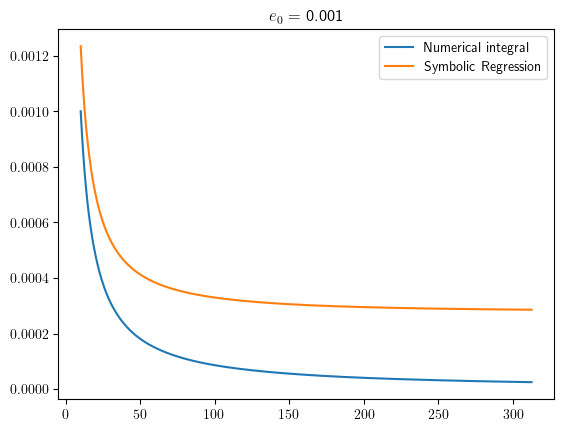

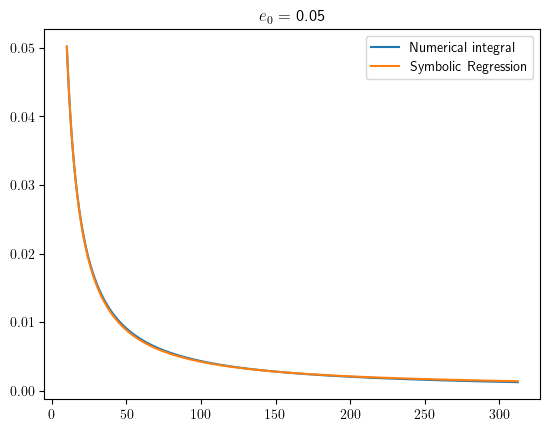

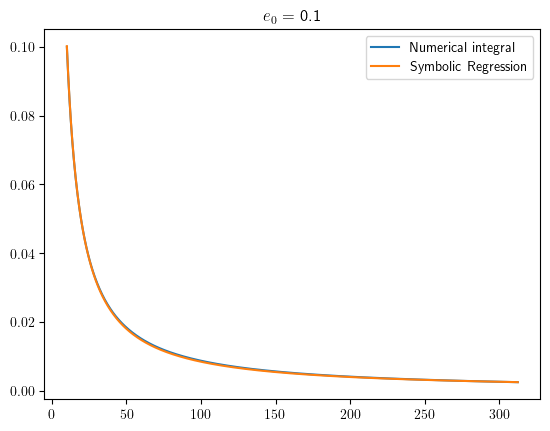

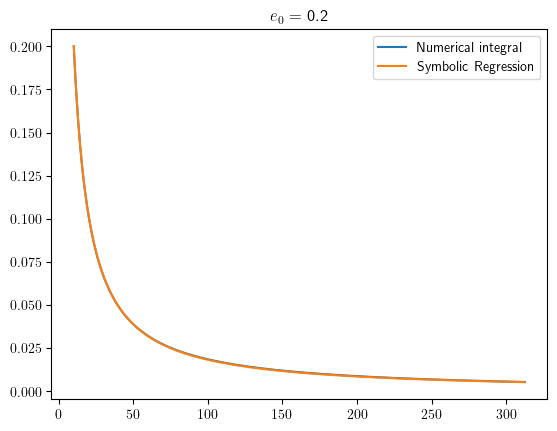

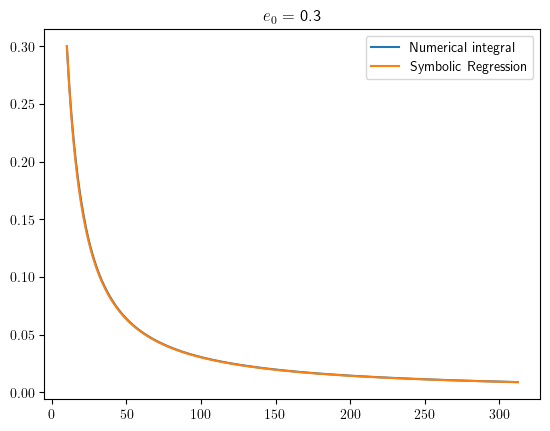

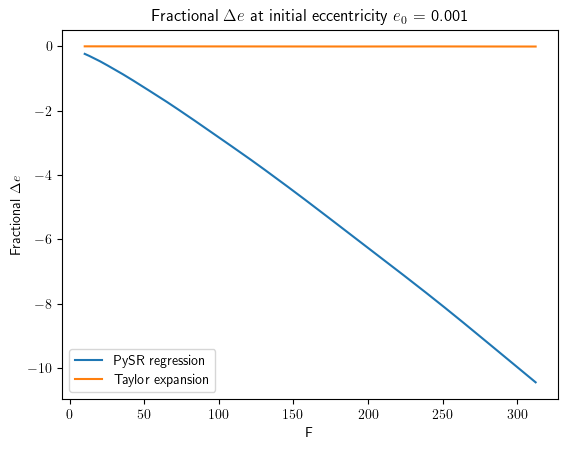

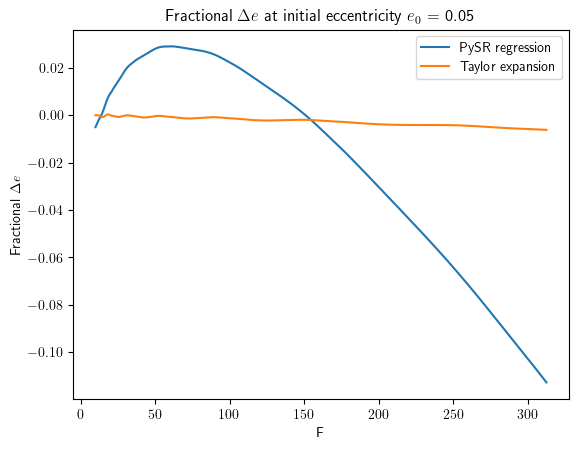

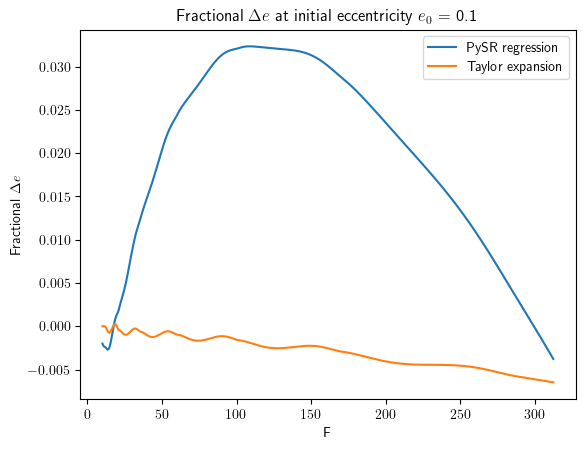

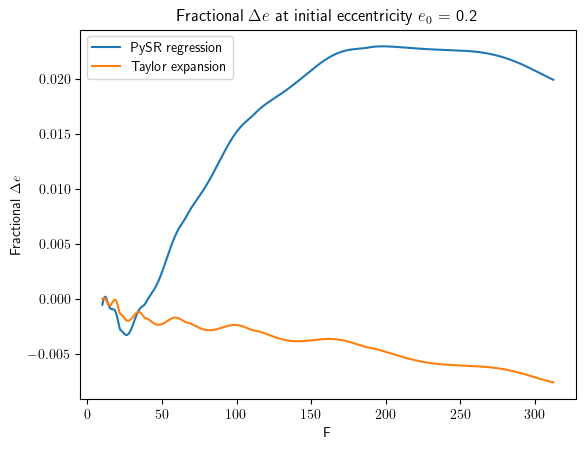

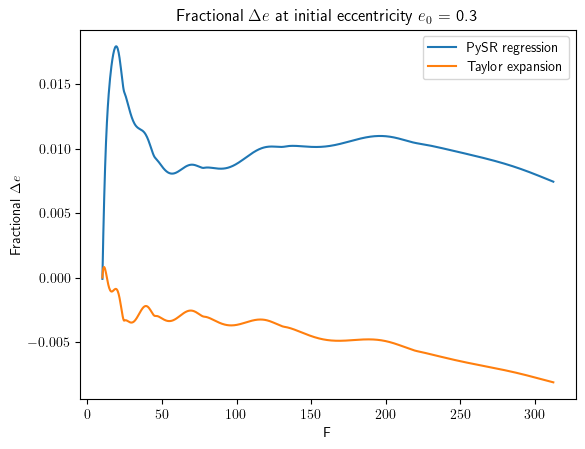

In [38]:
for i, e0 in enumerate(initialEccentricities):
    plt.plot(F, solutions[i], label = "Numerical integral")
    plt.plot(F, pysrfit(np.repeat(e0, N), F, (m1+m2), 1), label="Symbolic Regression")
    # plt.plot(F, yunes(np.repeat(e0, N), F), label="Yunes fit")
    plt.title(rf"$e_0$ = {e0}")
    plt.legend()
    plt.show()

for i, e0 in enumerate(initialEccentricities):
    plt.plot(F, (solutions[i] - pysrfit(np.repeat(e0, N), F, (m1+m2), 1)) / solutions[i], label = "PySR regression")
    plt.plot(F, (solutions[i] - expansion(np.repeat(e0, N), F, m1, m2)) / solutions[i], label = "Taylor expansion")
    # plt.plot(F, (solutions[i] - yunes(np.repeat(e0, N), F)) / solutions[i], label = "Yunes fit")
    plt.legend()
    plt.title(rf"Fractional $\Delta e$ at initial eccentricity $e_0$ = {e0}")
    plt.ylabel(r"Fractional $\Delta e$")
    plt.xlabel("F")
    plt.show()